In [2]:
import folium
import pandas as pd
import h3
from shapely.geometry import Polygon, Point
import shapely.wkt
from geojson import Point, Feature, FeatureCollection, dump
import seaborn as sns
from matplotlib import pyplot
from dateutil.parser import parse

# Discriptive Analysis

# Prices

In [3]:
dfPrices = pd.read_csv("auction_spot_germany_luxembourg_2019.csv",skiprows=1,sep=';')
dfPrices

,Delivery day,Hour1,Hour2,Hour3A,Hour3B,Hour4,Hour5,Hour6,Hour7,Hour8,...,Peakload\r\n(09-20),Night\r\n(01-06),Off-Peak 1\r\n(01-08),Business\r\n(09-16),Off-Peak\r\n(01-08 & 21-24),Morning\r\n(07-10),High Noon\r\n(11-14),Afternoon\r\n(15-18),Evening\r\n(19-24),Sun Peak\r\n(11-16)
0,31.12.2019,"24,14","22,12","13,01",NaN,"4,97","9,81","18,37","23,50","27,17",...,"40,36","15,40","17,89","37,78","25,11","31,92","36,93","41,48","41,99","37,55"
1,30.12.2019,"11,07","11,84","6,16",NaN,"1,40","4,81","16,43","26,90","30,38",...,"32,52","8,62","13,62","30,75","18,61","30,31","29,23","34,62","30,88","30,34"
2,29.12.2019,"30,60","28,10","26,92",NaN,"22,85","20,97","21,31","22,72","25,10",...,"33,30","25,13","24,82","30,67","27,03","26,35","31,04","34,29","34,42","31,31"
3,28.12.2019,"30,17","29,50","29,43",NaN,"28,20","28,53","27,40","29,20","31,63",...,"37,42","28,87","29,26","35,17","31,17","33,07","34,79","37,86","37,83","34,99"
4,27.12.2019,"31,17","30,02","28,67",NaN,"28,70","29,19","31,03","33,10","38,89",...,"42,64","29,80","31,35","40,86","32,99","37,64","40,26","45,81","39,00","41,39"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,05.01.2019,"26,90","25,12","24,12",NaN,"22,04","18,37","22,09","23,35","28,76",...,"51,30","23,11","23,84","47,62","33,06","32,30","49,69","54,67","54,51","50,65"
361,04.01.2019,"50,73","47,11","47,07",NaN,"46,94","47,00","46,91","49,59","55,32",...,"53,32","47,63","48,83","53,32","46,50","54,05","53,04","52,59","45,56","52,54"
362,03.01.2019,"42,91","45,22","45,63",NaN,"44,00","43,88","45,92","51,07","52,77",...,"65,00","44,59","46,43","63,16","50,43","56,69","62,34","67,74","61,76","63,73"
363,02.01.2019,"-33,57","-45,92","-48,29",NaN,"-44,99","-48,93","-29,91","-0,01","37,43",...,"51,39","-41,94","-26,77","47,44","0,44","34,06","44,36","54,07","57,29","46,79"


In [4]:
dfOnlyPrices = pd.DataFrame()

for column in dfPrices.columns:
    if 'Hour' in column and 'Rush' not in column:
        dfOnlyPrices[column] = dfPrices[column].str.replace(",",".").astype(float)

dfOnlyPrices.drop('Hour3B',axis=1,inplace=True)
dfOnlyPrices.rename(columns={'Hour3A':'Hour3'},inplace=True)
dfOnlyPrices.head()

,Hour1,Hour2,Hour3,Hour4,Hour5,Hour6,Hour7,Hour8,Hour9,Hour10,...,Hour15,Hour16,Hour17,Hour18,Hour19,Hour20,Hour21,Hour22,Hour23,Hour24
0,24.14,22.12,13.01,4.97,9.81,18.37,23.50,27.17,36.56,40.43,...,38.00,39.58,42.28,46.06,47.73,46.00,42.20,39.74,38.88,37.39
1,11.07,11.84,6.16,1.40,4.81,16.43,26.90,30.38,32.04,31.90,...,31.53,33.61,35.25,38.09,39.35,31.58,30.68,29.67,29.68,24.33
2,30.60,28.10,26.92,22.85,20.97,21.31,22.72,25.10,27.52,30.04,...,30.80,32.86,33.97,39.53,41.16,39.60,38.14,32.00,30.11,25.52
3,30.17,29.50,29.43,28.20,28.53,27.40,29.20,31.63,34.61,36.82,...,34.91,35.86,39.86,40.79,43.75,43.29,39.62,35.39,34.75,30.17
4,31.17,30.02,28.67,28.70,29.19,31.03,33.10,38.89,38.55,40.00,...,42.20,45.13,46.53,49.38,44.88,43.99,39.52,36.67,35.38,33.57


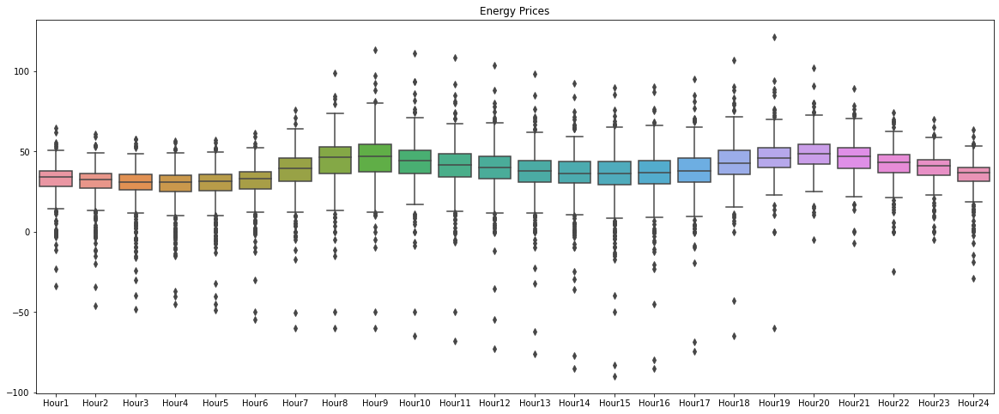

In [7]:
fig, ax = pyplot.subplots(figsize=(20, 8))
sns.boxplot(ax=ax, data=dfOnlyPrices).set_title('Energy Prices')
fig.savefig("energy_prices.png")

Text(0.5, 1.0, 'Energy Prices')

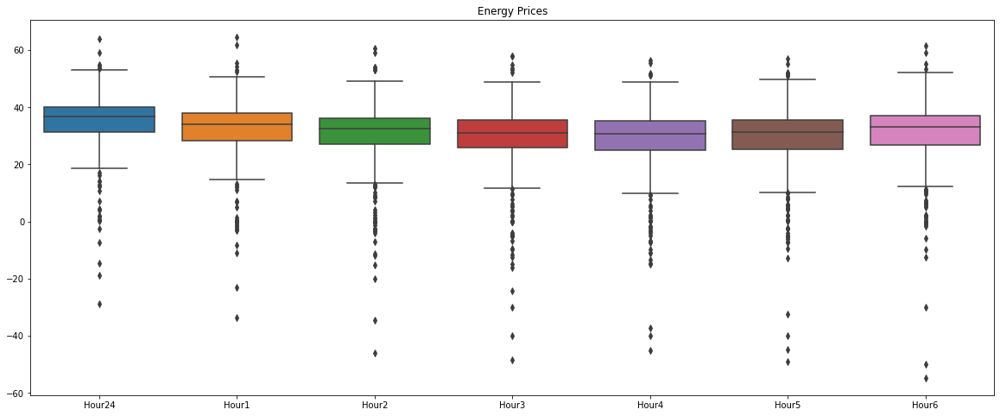

In [6]:
dfSelection = dfOnlyPrices[['Hour24','Hour1','Hour2','Hour3','Hour4','Hour5','Hour6',]]
fig, ax = pyplot.subplots(figsize=(20, 8))
sns.boxplot(ax=ax, data=dfSelection).set_title('Energy Prices')
fig.savefig("energy_prices.png")

# Demand Data

### Create a GeoJson

In [6]:
def output_h3_id_attributes(h3_id):
    return Polygon(h3.h3_to_geo_boundary(h3_id, geo_json=True))


dfDemand = pd.read_csv('sharenow_supply_data_6mo.csv')

list_EndUnique = list(dfDemand['hex_end_7'].unique())

features = []
for hexID in list_EndUnique:
    features.append(Feature(geometry=output_h3_id_attributes(hexID), properties={"hexID": hexID}))

feature_collection = FeatureCollection(features)

with open('berlin_hexagons.geojson', 'w') as f:
   dump(feature_collection, f)

In [7]:
hours = []
for value in dfDemand['datetime_start'].values:
    dt = parse(value)
    hours.append(dt.time().hour)
dfDemand['hour_start'] = hours

hours = []
for value in dfDemand['datetime_end'].values:
    dt = parse(value)
    hours.append(dt.time().hour)
dfDemand['hour_end'] = hours

In [8]:
dfDemand.value_counts('hour_start')

hour_start
23    60442
22    59985
21    48604
20    38360
19    32932
18    25947
17    17220
16    11641
15     8333
14     6520
13     4875
12     4040
11     3519
10     2999
9      2782
8      2581
7      1826
0      1142
6      1076
5      1007
4       750
1       717
2       541
3       520
dtype: int64

In [9]:
dfDemand.head()

,id,provider,platform,city,vehicleType,model,datetime_start,date_start,time_start,datetime_end,...,idle_duration_mins,geometry,hex_start_7,hex_end_7,hex_start_8,hex_end_8,hex_start_9,hex_end_9,hour_start,hour_end
0,ZnJlZWZsb2F0OjpjYXIyZ286OldCQTFSNTEwMDA1SzU2MjU2,car2go,drivenow,berlin,car,bmw 1er,2020-01-17 17:33:07+01:00,20200117,1730,2020-01-17 18:58:28+01:00,...,29.616667,POINT (13.52584 52.48457),871f1d4daffffff,871f1d4d0ffffff,881f1d4dadfffff,881f1d4d0dfffff,891f1d4dad7ffff,891f1d4d0cbffff,17,18
1,ZnJlZWZsb2F0OjpjYXIyZ286OldCQTFSNTEwMDA1SzU2MjU2,car2go,drivenow,berlin,car,bmw 1er,2020-01-18 21:48:09+01:00,20200118,2145,2020-01-18 22:13:27+01:00,...,25.016667,POINT (13.43196 52.48923000000001),871f1d4d2ffffff,871f1d48affffff,881f1d4d25fffff,881f1d48a5fffff,891f1d4d25bffff,891f1d48a43ffff,21,22
2,ZnJlZWZsb2F0OjpjYXIyZ286OldCQTFSNTEwMDA1SzU2MjU2,car2go,drivenow,berlin,car,bmw 1er,2020-01-19 18:23:28+01:00,20200119,1820,2020-01-19 18:58:25+01:00,...,69.966667,POINT (13.43525 52.50162),871f1d4d6ffffff,871f1d48effffff,881f1d4d67fffff,881f1d48e1fffff,891f1d4d667ffff,891f1d48e13ffff,18,18
3,ZnJlZWZsb2F0OjpjYXIyZ286OldCQTFSNTEwMDA1SzU2MjU2,car2go,drivenow,berlin,car,bmw 1er,2020-01-20 21:58:07+01:00,20200120,2155,2020-01-20 22:28:07+01:00,...,34.983333,POINT (13.3095 52.49525),871f1d49dffffff,871f1d499ffffff,881f1d49d5fffff,881f1d499bfffff,891f1d49d4bffff,891f1d499a3ffff,21,22
4,ZnJlZWZsb2F0OjpjYXIyZ286OldCQTFSNTEwMDA1SzU2MjU2,car2go,drivenow,berlin,car,bmw 1er,2020-01-21 23:53:07+01:00,20200121,2350,2020-01-22 00:18:25+01:00,...,299.683333,POINT (13.41951 52.53983),871f1d4f2ffffff,871f18b25ffffff,881f1d4f25fffff,881f18b253fffff,891f1d4f247ffff,891f18b252fffff,23,0


# Visulise

## Map _ Average Trip ends

In [10]:
df = dfDemand[dfDemand['fuel_end']<50].groupby(['date_start','hex_end_7'])['id'].count()
df = df.reset_index()
df

,date_start,hex_end_7,id
0,20191001,871f18840ffffff,1
1,20191001,871f18869ffffff,10
2,20191001,871f1886bffffff,2
3,20191001,871f18b04ffffff,4
4,20191001,871f18b0bffffff,1
...,...,...,...
10797,20200323,871f1d4a8ffffff,1
10798,20200323,871f1d4aeffffff,1
10799,20200323,871f1d4b3ffffff,1
10800,20200323,871f1d4c2ffffff,1


In [11]:
df = df[['hex_end_7','id']]
df = df.groupby('hex_end_7').sum()
df = df.reset_index()
df = df.rename(columns={'hex_end_7':'hexID','id':'trips'})
df

,hexID,trips
0,871f18840ffffff,47
1,871f18841ffffff,62
2,871f18869ffffff,1013
3,871f1886bffffff,741
4,871f18b02ffffff,1
...,...,...
82,871f1d4f1ffffff,177
83,871f1d4f2ffffff,4444
84,871f1d4f3ffffff,1066
85,871f1d4f4ffffff,741


In [12]:
df['trips'] = df['trips']/len(dfDemand.date_start.unique())

In [13]:
#Avoid black points 
#Get all hex ids
possibleIds = dfDemand.hex_end_7.unique()

for id in possibleIds:
    if id not in df['hexID'].unique():
        df = df.append({'hexID':id,'trips':0},ignore_index=True)

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=df, 
             columns=['hexID', 'trips'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='Average Trip Ends per Day')
f.add_child(map)

### Single hours

In [14]:
hour = 23
df = dfDemand[(dfDemand['hour_end']==hour) & (dfDemand['fuel_end'] < 50)]

df = df.groupby(['hour_end','hex_end_7'])['id'].count()
df = df.reset_index()
df = df.rename(columns={'hex_end_7':'hexID','id':'trips'})

df['trips'] = df['trips']/len(dfDemand['date_start'].unique())

#Avoid black points 
#Get all hex ids
possibleIds = dfDemand.hex_end_7.unique()

for id in possibleIds:
    if id not in df['hexID'].unique():
        df = df.append({'hexID':id,'trips':0},ignore_index=True)

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=df, 
             columns=['hexID', 'trips'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='Average Trip Ends per Day at {} a.m., SoC < 50%'.format(str(hour)))
f.add_child(map)

## Map _ Scenarios

In [15]:
dfScenarios = pd.read_csv('scenarios_multinomial.csv')
dfScenarios

FileNotFoundError: [Errno 2] No such file or directory: 'scenarios_multinomial.csv'

In [ ]:
df1 = dfScenarios.iloc[0]
df1 = df1.T
df1 = df1.reset_index()
df1 = df1.rename(columns={'index':'hexID',0:'low_soc_cars'})
df1 = df1[df1['hexID']!='probs']

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=df1, 
             columns=['hexID', 'low_soc_cars'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='#Cars with SoC < 50%')
f.add_child(map)

In [ ]:
df1 = dfScenarios.iloc[1]
df1 = df1.T
df1 = df1.reset_index()
df1 = df1.rename(columns={'index':'hexID',1:'low_soc_cars'})
df1 = df1[df1['hexID']!='probs']

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=df1, 
             columns=['hexID', 'low_soc_cars'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='#Cars with SoC < 50%')
f.add_child(map)

In [ ]:
df1 = dfScenarios.iloc[2]
df1 = df1.T
df1 = df1.reset_index()
df1 = df1.rename(columns={'index':'hexID',2:'low_soc_cars'})
df1 = df1[df1['hexID']!='probs']

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=df1, 
             columns=['hexID', 'low_soc_cars'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='#Cars with SoC < 50%')
f.add_child(map)

In [ ]:
df1 = dfScenarios.iloc[3]
df1 = df1.T
df1 = df1.reset_index()
df1 = df1.rename(columns={'index':'hexID',3:'low_soc_cars'})
df1 = df1[df1['hexID']!='probs']

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=df1, 
             columns=['hexID', 'low_soc_cars'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='#Cars with SoC < 50%')
f.add_child(map)

## Map _ Chargers (Model results)

In [ ]:
chargerPerHex = pd.read_csv('charger_in_hex.csv')
finalData = chargerPerHex[['hexID']]
chargerPerHex = chargerPerHex[['x1','x2','x3']].sum(axis=1)
finalData['charger'] = chargerPerHex

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=finalData, 
             columns=['hexID', 'charger'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='Charger')
f.add_child(map)

In [ ]:
## Probabiliteis by mult. distribution

In [ ]:
chargerPerHex = pd.read_csv('probs.csv')
chargerPerHex

In [ ]:
chargerPerHex = pd.read_csv('probs.csv')
chargerPerHex

f = folium.Figure(width=500, height=500)
map = folium.Map(location=[52.518839, 13.399304], default_zoom_start=30)
map.choropleth(geo_data="berlin_hexagons.geojson",
             data=chargerPerHex, 
             columns=['hexID', 'prob'], 
             key_on='feature.properties.hexID', 
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='prob')
f.add_child(map)

# Further Visualization

In [172]:
df['temp']

0          6.1
1          2.8
2          3.9
3          1.1
4          2.8
          ... 
338354    13.9
338355    11.1
338356     7.8
338357     8.9
338358     5.0
Name: temp, Length: 338359, dtype: float64

In [151]:
precipitation = []
for value in df['precipitation'].values:
    if value == False:
        precipitation.append(0)
    else:
        precipitation.append(1)

df['precipitation'] = precipitation

In [170]:
precipitation = df.groupby(['month']).mean()['precipitation']
dfPrecipitation = pd.DataFrame(precipitation).reset_index()
dfPrecipitation

,month,precipitation
0,1,0.177641
1,2,0.189196
2,3,0.079179
3,10,0.090814
4,11,0.117374
5,12,0.144440


Text(0.5, 1.0, 'Number of Trips per Month')

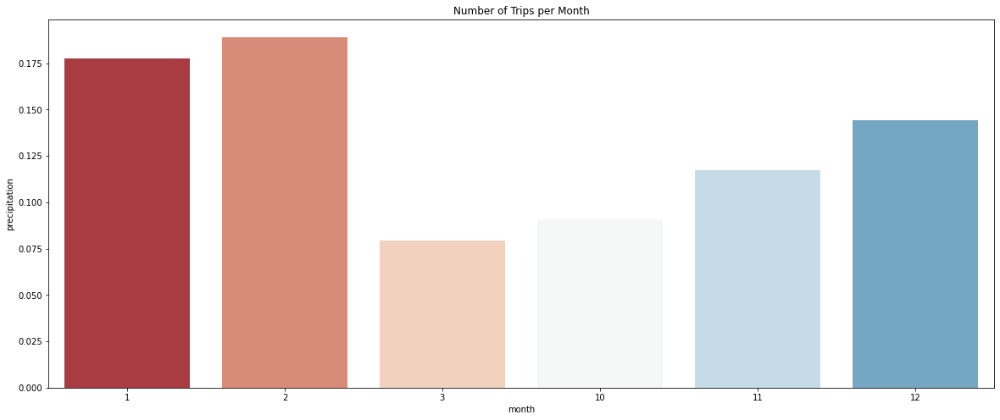

In [171]:
fig, ax = pyplot.subplots(figsize=(20, 8))
sns.barplot(ax=ax, data = dfPrecipitation, x='month', y='precipitation', palette=sns.color_palette("RdBu", 7)).set_title('Number of Trips per Month')

In [173]:
precipitation = df.groupby(['month']).mean()['temp']
dfPrecipitation = pd.DataFrame(precipitation).reset_index()
dfPrecipitation

,month,temp
0,1,4.311908
1,2,6.131654
2,3,6.978423
3,10,11.586569
4,11,6.582985
5,12,4.764087


Text(0.5, 1.0, 'Number of Trips per Month')

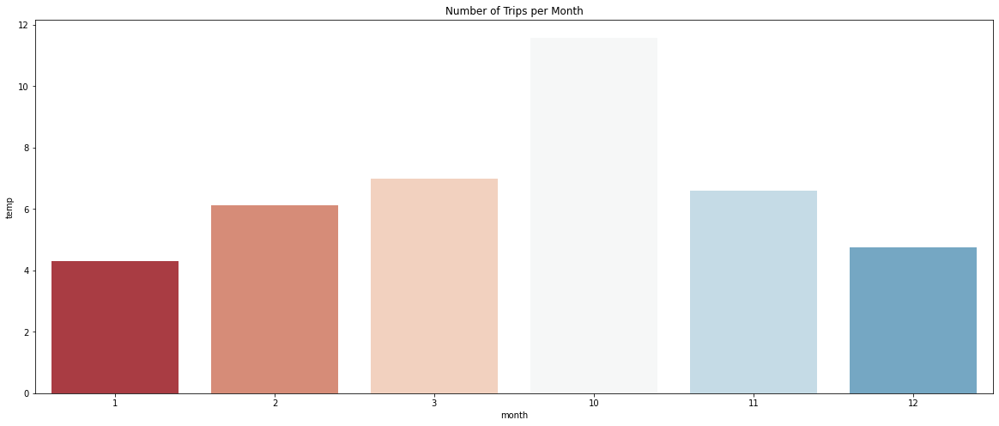

In [174]:
fig, ax = pyplot.subplots(figsize=(20, 8))
sns.barplot(ax=ax, data = dfPrecipitation, x='month', y='temp', palette=sns.color_palette("RdBu", 7)).set_title('Number of Trips per Month')

In [42]:
df = pd.read_csv('sharenow_supply_data_6mo.csv')

In [43]:
df['duration_mins_rounded'] = round(df['duration_mins'],0)

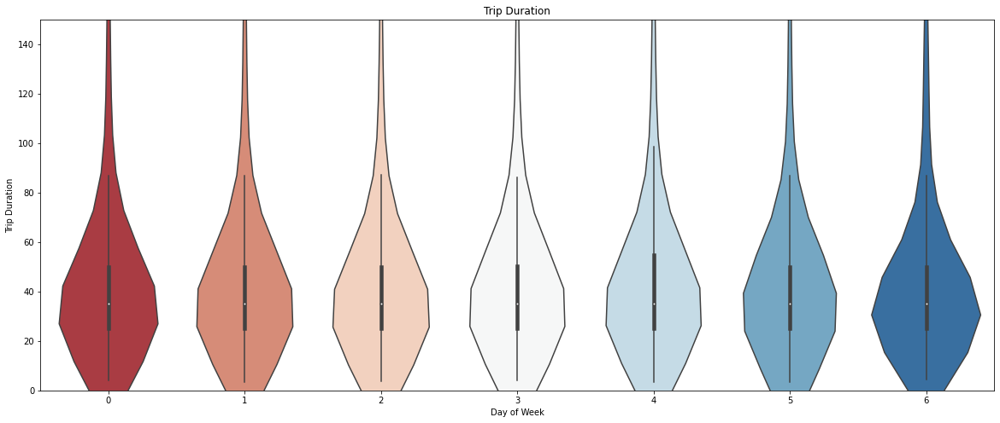

In [175]:
fig, ax = pyplot.subplots(figsize=(20, 8))
ax.set(ylim=(0,150))
sns.violinplot(ax=ax, data=df, x='dayofweek',y='duration_mins',palette=sns.color_palette("RdBu", 7)).set_title('Trip Duration')
ax.set(xlabel='Day of Week', ylabel='Trip Duration')
fig.savefig("Trip_Duration.png")

In [45]:
hours = []
for value in df['datetime_start'].values:
    dt = parse(value)
    hours.append(dt.time().hour)
df['hour_start'] = hours

hours = []
for value in df['datetime_end'].values:
    dt = parse(value)
    hours.append(dt.time().hour)
df['hour_end'] = hours

In [92]:
month = []
for value in df['datetime_start'].values:
    dt = parse(value)
    month.append(dt.month)
df['month'] = month

In [163]:
dfNew.sort_values('#drives',ascending=False)

,month,#drives
0,10,69978
1,11,64401
2,12,62379
3,1,52229
4,2,49816
5,3,39556


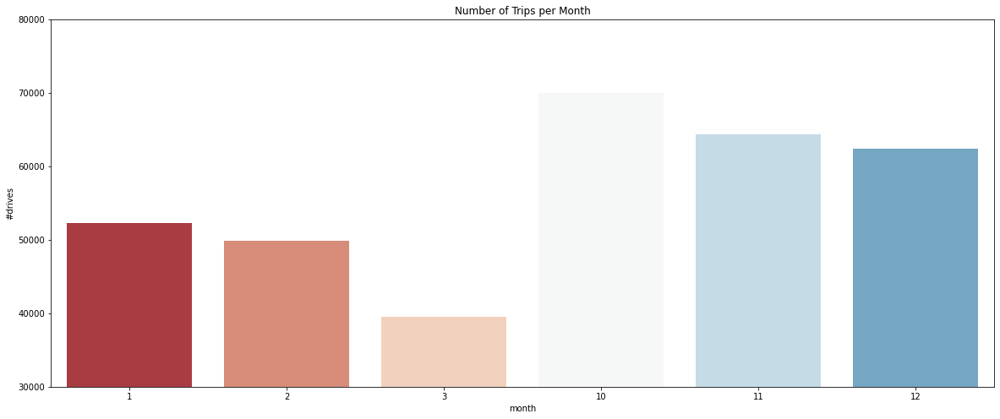

In [164]:
dfNew = pd.DataFrame(df.value_counts('month')).reset_index()
dfNew = dfNew.rename(columns={0:'#drives'})

fig, ax = pyplot.subplots(figsize=(20, 8))
ax.set(ylim=(30000,80000))
sns.barplot(ax=ax, data = dfNew, x= 'month', y='#drives', palette=sns.color_palette("RdBu", 7)).set_title('Number of Trips per Month')
fig.savefig("number_trips_per_month.png")

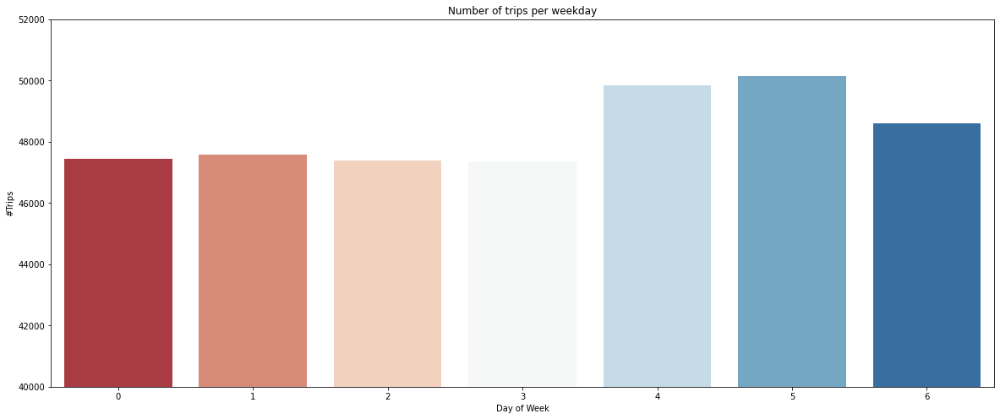

In [132]:
dfNew = pd.DataFrame(df.value_counts('dayofweek')).reset_index()
dfNew = dfNew.rename(columns={0:'#Trips'})

fig, ax = pyplot.subplots(figsize=(20, 8))
ax.set(ylim=(40000,52000))
sns.barplot(ax=ax, data = dfNew, x= 'dayofweek', y='#Trips', palette=sns.color_palette("RdBu", 7)).set_title('Number of trips per weekday')
ax.set(xlabel='Day of Week', ylabel='#Trips')
fig.savefig("number_trips_per_weekday.png")

In [133]:
dfNew = pd.DataFrame(df.value_counts('month')).reset_index()
dfNew = dfNew.rename(columns={0:'#TripsMonthly'})

dfNew2 = pd.DataFrame(df.value_counts(['month','dayofweek'])).reset_index()
dfNew2 = dfNew2.rename(columns={0:'#Trips'})
dfNewM = dfNew2.merge(dfNew, on='month')
dfNewM['percentage_trips_weekday_monthly'] = dfNewM['#Trips']/dfNewM['#TripsMonthly']

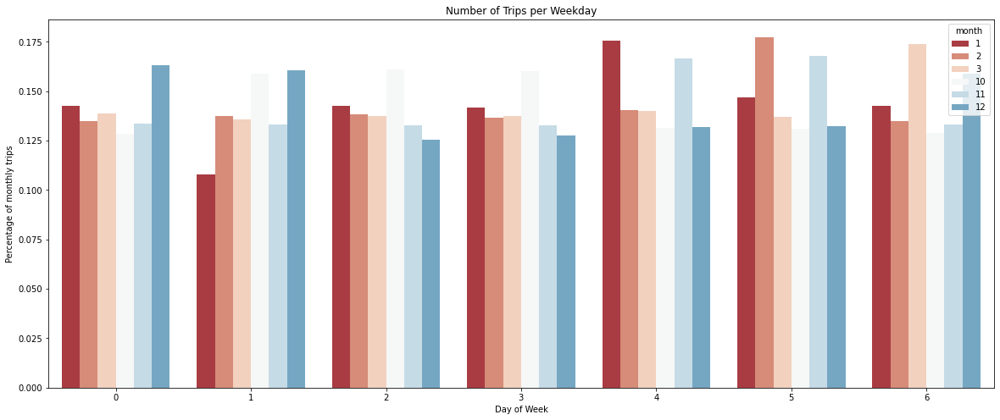

In [135]:
fig, ax = pyplot.subplots(figsize=(20, 8))
#ax.set(ylim=(44000,52000))
sns.barplot(ax=ax, data = dfNewM, x= 'dayofweek', y='percentage_trips_weekday_monthly',  hue='month', palette=sns.color_palette("RdBu", 7)).set_title('Number of Trips per Weekday')
ax.set(xlabel='Day of Week', ylabel='Percentage of monthly trips')
fig.savefig("percentual_trips_per_weekday_monthly.png")

In [58]:
import numpy as np

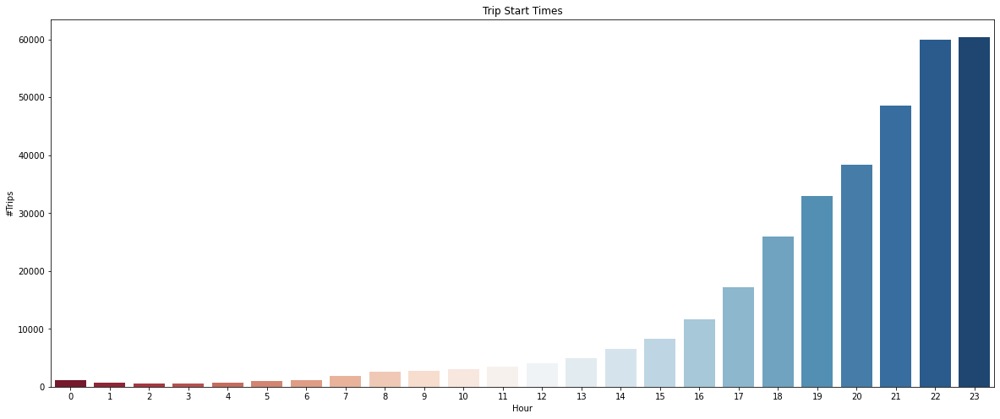

In [176]:
fig, ax = pyplot.subplots(figsize=(20, 8))

sns.countplot(data=df, x='hour_start',palette=sns.color_palette("RdBu", 24)).set_title('Trip Start Times')

ax.set(xlabel='Hour', ylabel='#Trips')
fig.savefig("trip_starts_hourly.png")

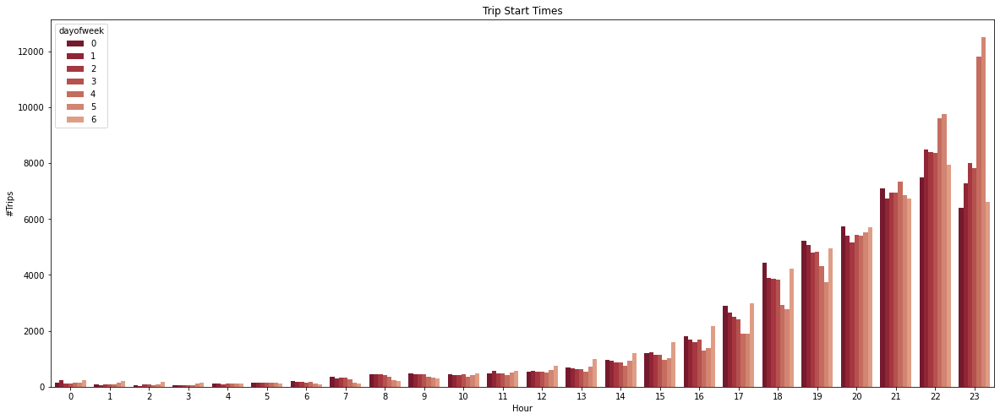

In [177]:
fig, ax = pyplot.subplots(figsize=(20, 8))

sns.countplot(data=df, x='hour_start',hue='dayofweek',palette=sns.color_palette("RdBu", 24)).set_title('Trip Start Times')
ax.set(xlabel='Hour', ylabel='#Trips')
fig.savefig("trip_starts_hourly.png")

Text(0.5, 1.0, 'Trip Start Times')

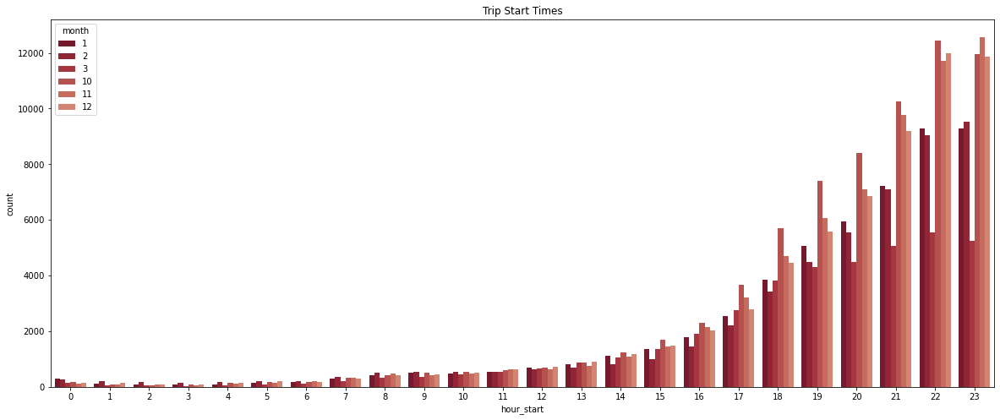

In [56]:
fig, ax = pyplot.subplots(figsize=(20, 8))

sns.countplot(data=df, x='hour_start',hue='month',palette=sns.color_palette("RdBu", 24)).set_title('Trip Start Times')


Text(0.5, 1.0, 'Duration')

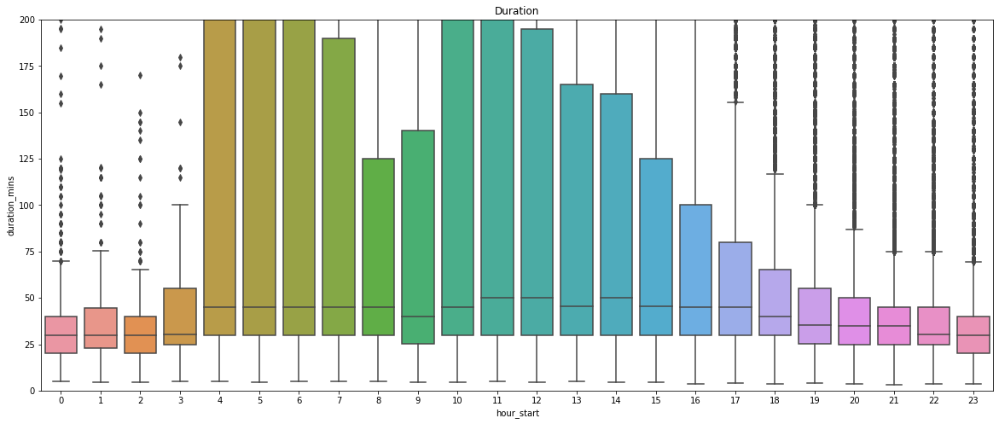

In [60]:
fig, ax = pyplot.subplots(figsize=(20, 8))
ax.set(ylim=(0,200))
sns.boxplot(ax=ax, data=df, x='hour_start',y='duration_mins').set_title('Duration')

In [61]:
df2 = pd.DataFrame(df.value_counts('hour_start'),columns=['#drives'])
df2 = df2.reset_index()
df2 = df2.sort_values('hour_start')

Text(0.5, 1.0, 'Number of Trips per Hour')

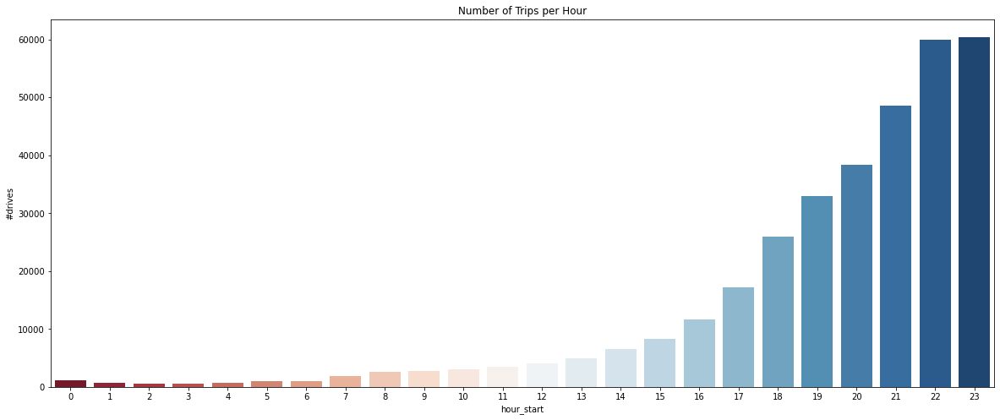

In [62]:
fig, ax = pyplot.subplots(figsize=(20, 8))
#ax.set(ylim=(44000,52000))
sns.barplot(ax=ax, data = df2, x= 'hour_start', y='#drives', palette=sns.color_palette("RdBu", 24)).set_title('Number of Trips per Hour')

<BarContainer object of 24 artists>

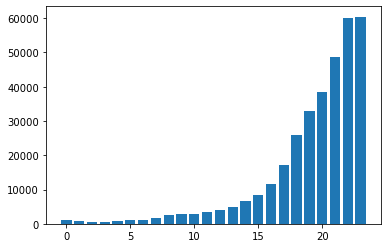

In [63]:
pyplot.bar(df2['hour_start'],df2['#drives'])

([0, 1, 2, 3, 4, 5, 6, 7, 8],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

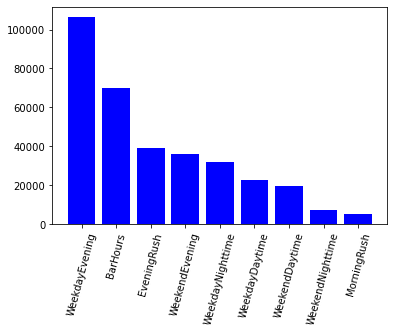

In [64]:
df3 = pd.DataFrame(df.value_counts('time_basket'),columns=['#drives'])
df3 = df3.reset_index()

pyplot.bar(df3['time_basket'],df3['#drives'],color='blue')
pyplot.xticks(rotation=75)

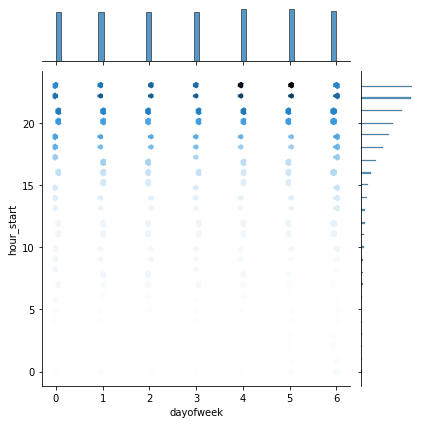

In [65]:
sns.jointplot(data=df, x="dayofweek", y="hour_start",kind='hex')

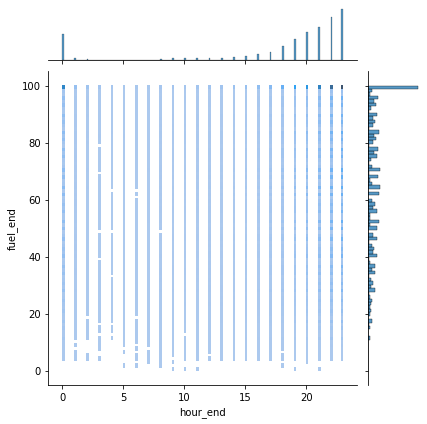

In [66]:
sns.jointplot(data=df, x="hour_end", y="fuel_end",kind='hist')

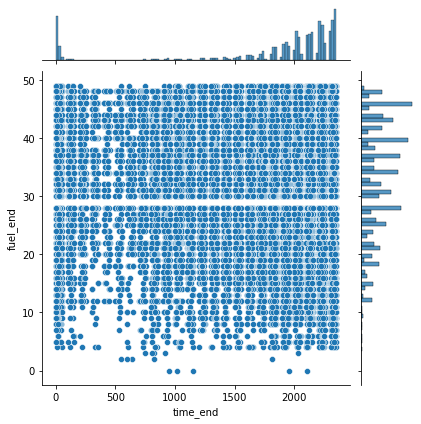

In [67]:
lowFuel = df[df['fuel_end'] < 50]
sns.jointplot(data=lowFuel, x="time_end", y="fuel_end", palette=sns.color_palette("RdBu"))